In [4]:
import pandas as pd

file_path = 'data/anime.csv'

df_main = pd.read_csv(file_path)

# Convert the "Score" column to numeric and round it to integer values
df_main["Score"] = pd.to_numeric(df_main["Score"], errors='coerce').round().astype('Int64')


# Randomize the order of rows
df = df_main.sample(frac=1).reset_index(drop=True)  # frac=1 means selecting all rows, random_state for reproducibility

# Keep only the first 30 lines
df = df.head(50)

print(df.head())


   MAL_ID                              Name  Score  \
0   30196          Tsubasa to Hotaru (2015)      6   
1    9528    Transformers Superlink Special      6   
2    1614     Captain Tsubasa: Road to 2002      7   
3   41587  Boku no Hero Academia 5th Season   <NA>   
4   29767                            Minamo   <NA>   

                                         Genres     English name  \
0                       Romance, School, Shoujo          Unknown   
1       Sci-Fi, Adventure, Kids, Mecha, Shounen          Unknown   
2                       Action, Sports, Shounen  Captain Tsubasa   
3  Action, Comedy, Super Power, School, Shounen          Unknown   
4                                       Unknown          Unknown   

       Japanese name     Type Episodes                        Aired  \
0            つばさとホタル  Special        4  Mar 6, 2015 to Mar 27, 2015   
1  トランスフォーマー スーパーリンク  Special        1                  Nov 3, 2004   
2      キャプテン翼 (2001)       TV       52   Oct 7, 2001 

In [11]:
not_column = ["MAL_ID", "Name", "Ended", "Ranked", "Duration", "English name", "Japanese name", "Score-10", "Score-9", "Score-8", "Score-7", "Score-6", "Score-5", "Score-4", "Score-3", "Score-2", "Score-1", "Premiered", "Producers", "Licensors", "Studios", "Popularity", "Members", "Favorites", "Watching", "Completed", "On-Hold", "Dropped", "Plan to Watch"]

result_df = pd.DataFrame(columns=['head', 'relation', 'tail'])

for column in df.columns:
    if column not in not_column:
        if column == 'Genres':
            genre_lists = df[column].str.split(', ')
            for idx, genres in enumerate(genre_lists):
                for genre in genres:
                    temp_df = pd.DataFrame({'head': df['Name'][idx],
                                            'relation': 'Genre',
                                            'tail': genre}, index=[0])
                    result_df = pd.concat([result_df, temp_df], ignore_index=True)
                    
        elif column == 'Aired':
            df['started'] = df[column].str.extract(r'(\d{4})')        
            
        else:
            temp_df = pd.DataFrame({'head': df['Name'],
                                    'relation': column,
                                    'tail': df[column].apply(lambda x: x if pd.notna(x) and x != '' else 'Unknown')}) # Replace empty or NaN values with "Unknown"
            result_df = pd.concat([result_df, temp_df], ignore_index=True)

result_df = result_df.drop_duplicates()

result_df.to_csv('result.csv', index=False)
print(result_df.head())

                               head relation     tail
0          Tsubasa to Hotaru (2015)    Score      6.0
1    Transformers Superlink Special    Score      6.0
2     Captain Tsubasa: Road to 2002    Score      7.0
3  Boku no Hero Academia 5th Season    Score  Unknown
4                            Minamo    Score  Unknown


C:\Users\Tuts\AppData\Local\Temp\ipykernel_16004\1914829166.py:21: UserWarning: Glyph 65343 (\N{FULLWIDTH LOW LINE}) missing from current font.
  plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed
C:\Users\Tuts\AppData\Local\Temp\ipykernel_16004\1914829166.py:21: UserWarning: Glyph 65290 (\N{FULLWIDTH ASTERISK}) missing from current font.
  plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed
C:\Users\Tuts\AppData\Local\Temp\ipykernel_16004\1914829166.py:21: UserWarning: Glyph 65306 (\N{FULLWIDTH COLON}) missing from current font.
  plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed
C:\Users\Tuts\AppData\Local\Temp\ipykernel_16004\1914829166.py:21: UserWarning: Glyph 65509 (\N{FULLWIDTH YEN SIGN}) missing from current font.
  plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed
C:\Users\Tuts\AppData\Local\Temp\ipykernel_

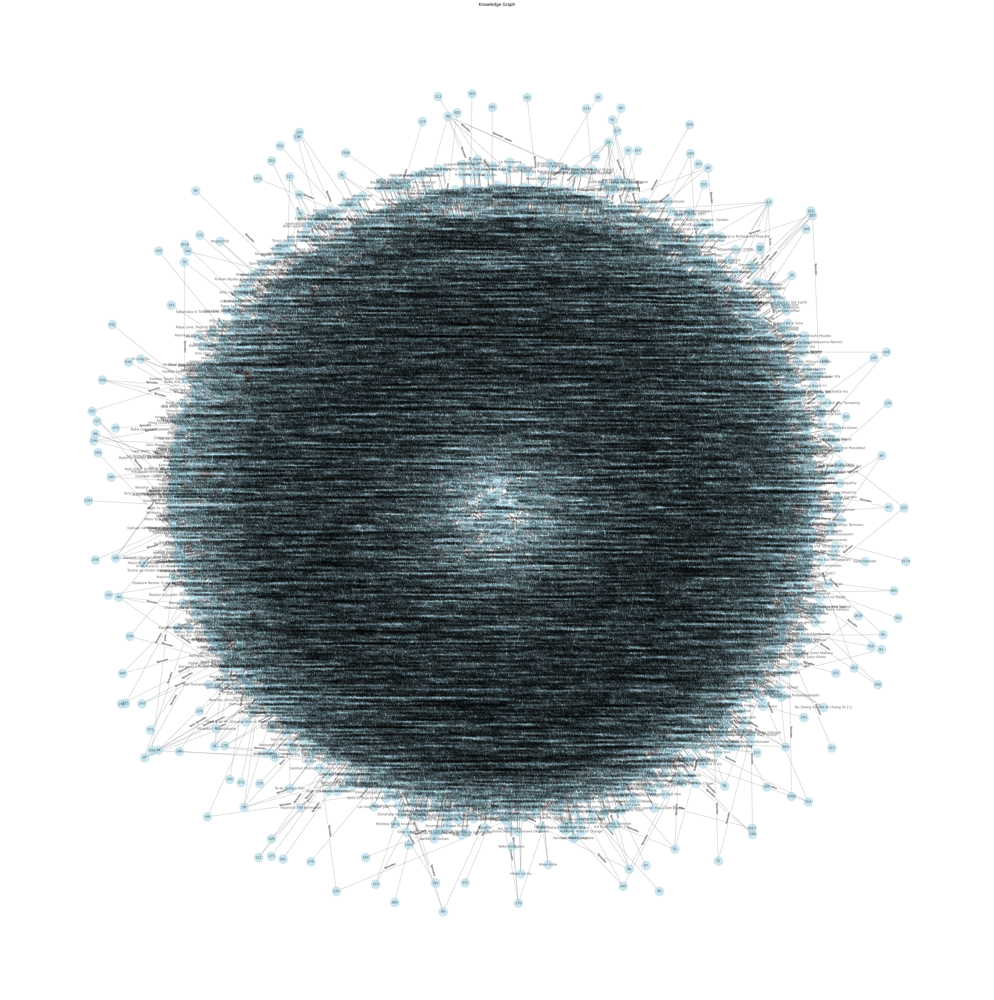

In [33]:
import networkx as nx
import matplotlib.pyplot as plt


# Create a knowledge graph
G = nx.Graph()
for _, row in result_df.iterrows():
    if row['relation'] != '':  # Filter out only genre relations
        G.add_edge(row['head'], row['tail'], label=row['relation'])
    

# Visualize the knowledge graph with modified layout parameters
pos = nx.spring_layout(G, seed=42, k=0.15)  # Adjust the 'k' parameter for node separation
labels = nx.get_edge_attributes(G, 'label')
plt.figure(figsize=(40, 40))  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, font_size=10, node_size=700, node_color='lightblue', edge_color='gray', alpha=0.6)
nx.draw_networkx_edge_labels(G, pos, edge_labels=labels, font_size=8, label_pos=0.3, verticalalignment='baseline')
plt.title('Knowledge Graph')

# Save the image
plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed

# Display the plot
plt.show()


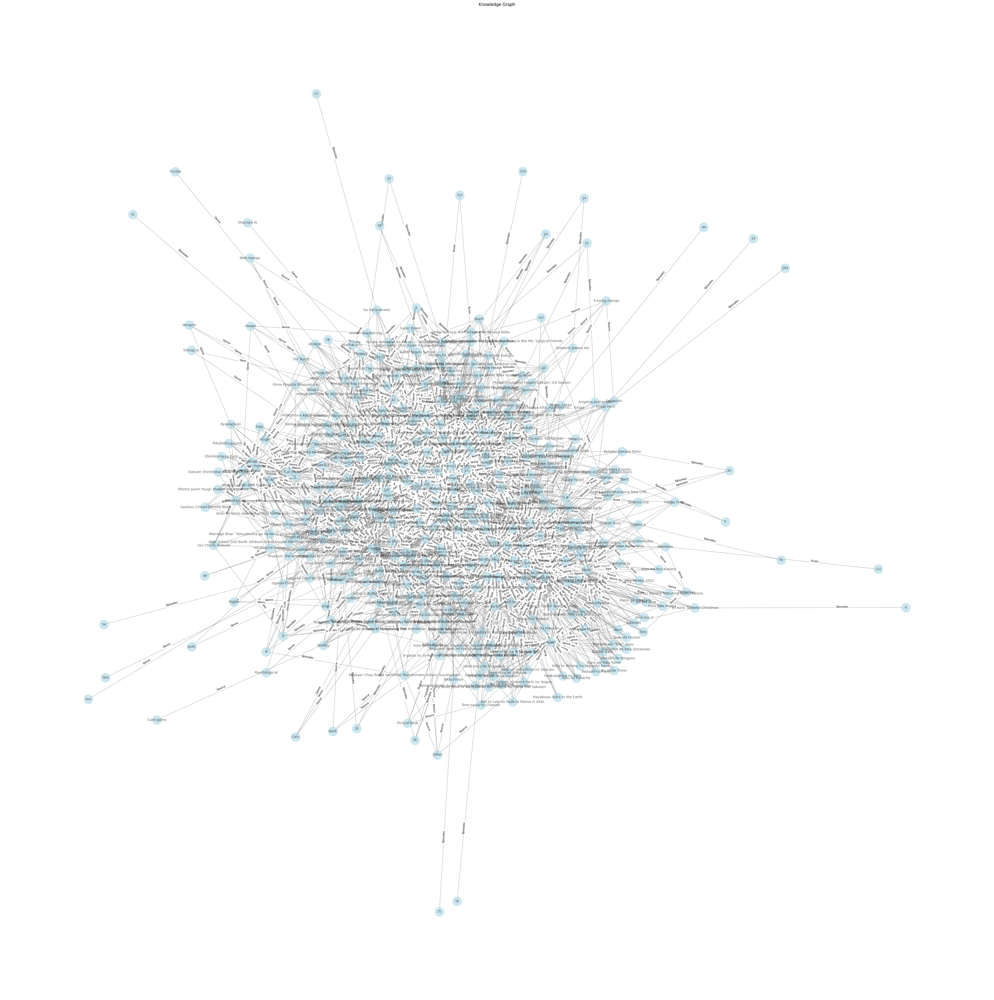

In [36]:
import networkx as nx
import matplotlib.pyplot as plt


# Create a knowledge graph
G = nx.Graph()
for _, row in result_df.iterrows():
    if row['relation'] != '':  # Filter out only genre relations
        G.add_edge(row['head'], row['tail'], label=row['relation'])
    

# Visualize the knowledge graph with modified layout parameters
pos = nx.spring_layout(G, seed=42, k=0.15)  # Adjust the 'k' parameter for node separation
labels = nx.get_edge_attributes(G, 'label')
plt.figure(figsize=(40, 40))  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, font_size=10, node_size=700, node_color='lightblue', edge_color='gray', alpha=0.6)
nx.draw_networkx_edge_labels(G, pos, edge_labels=labels, font_size=8, label_pos=0.3, verticalalignment='baseline')
plt.title('Knowledge Graph')

# Save the image
plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed

# Display the plot
plt.show()


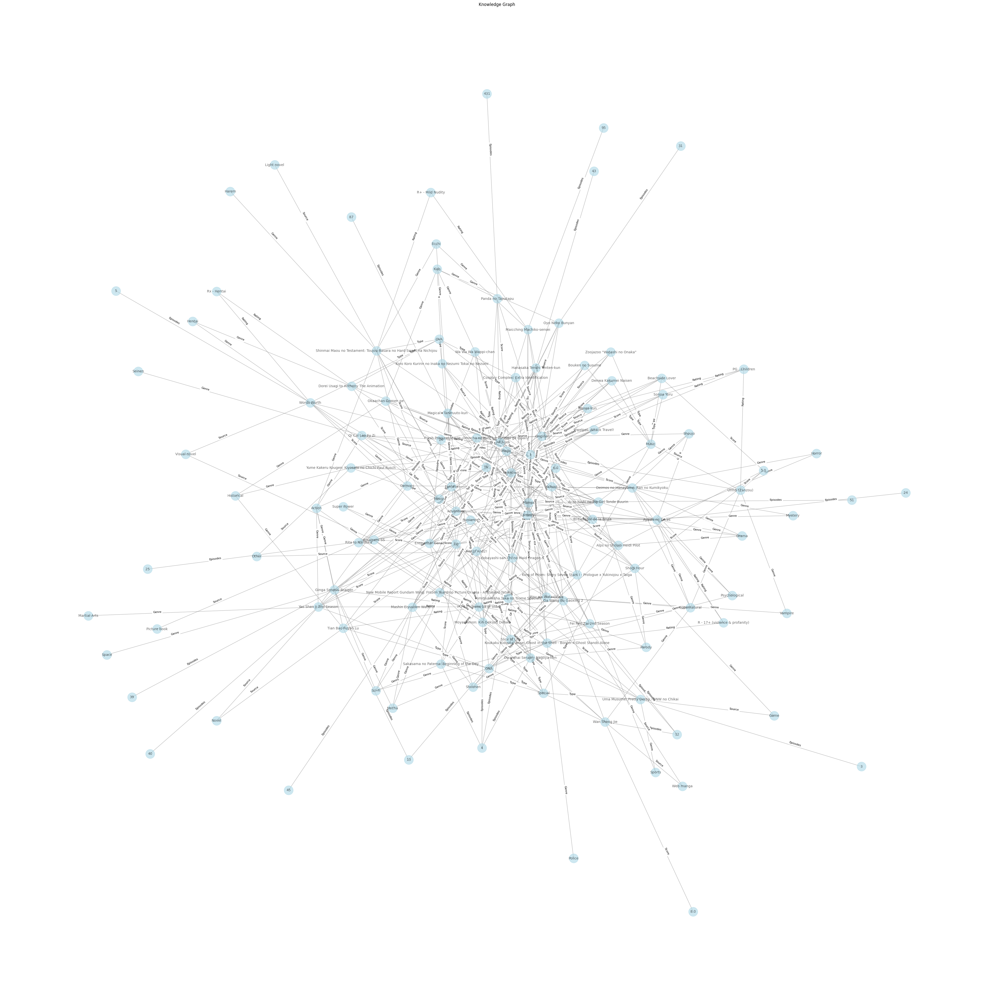

In [39]:
import networkx as nx
import matplotlib.pyplot as plt


# Create a knowledge graph
G = nx.Graph()
for _, row in result_df.iterrows():
    if row['relation'] != '':  # Filter out only genre relations
        G.add_edge(row['head'], row['tail'], label=row['relation'])
    

# Visualize the knowledge graph with modified layout parameters
pos = nx.spring_layout(G, seed=42, k=0.15)  # Adjust the 'k' parameter for node separation
labels = nx.get_edge_attributes(G, 'label')
plt.figure(figsize=(40, 40))  # Adjust the figure size as needed
nx.draw(G, pos, with_labels=True, font_size=10, node_size=700, node_color='lightblue', edge_color='gray', alpha=0.6)
nx.draw_networkx_edge_labels(G, pos, edge_labels=labels, font_size=8, label_pos=0.3, verticalalignment='baseline')
plt.title('Knowledge Graph')

# Save the image
plt.savefig('knowledge_graph.png', dpi=300)  # You can adjust the file name and DPI as needed

# Display the plot
plt.show()


In [17]:
class Vertice:
    def __init__(self, valor):
        self.valor = valor
        self.adjacentes = []

class Aresta:
    def __init__(self, vertice_origem, vertice_destino, relation):
        self.vertice_origem = vertice_origem
        self.vertice_destino = vertice_destino
        self.relation = relation

class Grafo:
    def __init__(self):
        self.vertices = []
        self.arestas = []

    def numVertices(self):
        return len(self.vertices)

    def numArestas(self):
        return len(self.arestas)

    def grau(self, vertice):
        """
        Retorna o grau do vértice, que é o número de arestas incidentes a ele.
        """
        return sum(1 for aresta in self.arestas if vertice in (aresta.vertice_origem, aresta.vertice_destino))

    def verticesAdjacentes(self, vertice):
        """
        Retorna uma lista de vértices adjacentes ao vértice dado.
        """
        adjacentes = []
        for aresta in self.arestas:
            if aresta.vertice_origem == vertice:
                adjacentes.append(aresta.vertice_destino)
            elif aresta.vertice_destino == vertice:
                adjacentes.append(aresta.vertice_origem)
        return adjacentes

    def arestasIncidentes(self, vertice):
        """
        Retorna uma lista de arestas incidentes ao vértice dado.
        """
        arestas = []
        for aresta in self.arestas:
            if aresta.vertice_origem == vertice or aresta.vertice_destino == vertice:
                arestas.append(aresta)
        return arestas

    def saoAdjacentes(self, vertice1, vertice2):
        return vertice2 in vertice1.adjacentes

    def adicionaVertice(self, valor):
        vertice = Vertice(valor)
        self.vertices.append(vertice)
        return vertice
    
    def adicionaAresta(self, vertice_origem, vertice_destino, relation):
        aresta = Aresta(vertice_origem, vertice_destino, relation)
        self.arestas.append(aresta)
        vertice_origem.adjacentes.append(vertice_destino)
        vertice_destino.adjacentes.append(vertice_origem)
    
    def insereVertice(self, valor):
        vertice = Vertice(valor)
        self.vertices.append(vertice)
        with open(file_path, 'a', newline='') as csvfile:
            fieldnames = ['head', 'relation', 'tail']
            writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
            writer.writerow({'head': vertice.valor, 'relation': '', 'tail': ''})
        return vertice

    def insereAresta(self, vertice_origem, vertice_destino, relation):
        aresta = Aresta(vertice_origem, vertice_destino, relation)
        self.arestas.append(aresta)
        vertice_origem.adjacentes.append(vertice_destino)
        vertice_destino.adjacentes.append(vertice_origem)
        with open(file_path, 'a', newline='') as csvfile:
            fieldnames = ['head', 'relation', 'tail']
            writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
            writer.writerow({'head': vertice_destino.valor, 'relation': relation, 'tail': vertice_destino.valor})
        return pd.read_csv(file_path)

    def removeVertice(self, valor):
        vertices_to_remove = [v for v in self.vertices if v.valor == valor]
        for vertice in vertices_to_remove:
            self.vertices.remove(vertice)
            for v in self.vertices:
                if vertice in v.adjacentes:
                    v.adjacentes.remove(vertice)
            for aresta in self.arestas:
                if aresta.vertice_origem == vertice or aresta.vertice_destino == vertice:
                    self.arestas.remove(aresta)
        self.escreverCSV(file_path, grafo)
        return pd.read_csv(file_path)

    def removeAresta(self, aresta):
        self.arestas.remove(aresta)
        aresta.vertice_origem.adjacentes.remove(aresta.vertice_destino)
        aresta.vertice_destino.adjacentes.remove(aresta.vertice_origem)

    def escreverCSV(self, arquivo, grafo):
        with open(arquivo, 'w', newline='') as csvfile:
            fieldnames = ['head', 'relation', 'tail']
            writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
            writer.writeheader()
            for aresta in grafo.arestas:
                writer.writerow({'head': aresta.vertice_origem.valor, 'relation': aresta.relation, 'tail': aresta.vertice_destino.valor})

def lerCSV(arquivo):
    grafo = Grafo()
    vertices = {}  # Dicionário para mapear valores de vértices para instâncias de vértices
    with open(arquivo, newline='') as csvfile:
        reader = csv.DictReader(csvfile)
        for row in reader:
            head = row['head']
            tail = row['tail']
            relation = row['relation']
            
            # Verificar se o vértice de origem já foi adicionado
            if head not in vertices:
                vertice_origem = grafo.adicionaVertice(head)
                vertices[head] = vertice_origem
            else:
                vertice_origem = vertices[head]
            
            # Verificar se o vértice de destino já foi adicionado
            if tail not in vertices:
                vertice_destino = grafo.adicionaVertice(tail)
                vertices[tail] = vertice_destino
            else:
                vertice_destino = vertices[tail]
                
            grafo.adicionaAresta(vertice_origem, vertice_destino, relation)
    return grafo

# Teste das funcionalidades corrigidas
grafo = lerCSV('result.csv')

print("Número de vértices:", grafo.numVertices())
print("Número de arestas:", grafo.numArestas())

# Obtendo o grau de um vértice específico
vertice_exemplo = grafo.vertices[0]  # Suponha que você queira verificar o grau do primeiro vértice na lista
print("Grau do vértice:", grafo.grau(vertice_exemplo))

# Obtendo os vértices adjacentes a um vértice específico
print("Vértices adjacentes:", [v.valor for v in grafo.verticesAdjacentes(vertice_exemplo)])

# Checando se dois vértices são adjacentes
vertice1 = grafo.vertices[0]  # Suponha que você queira verificar a adjacência entre o primeiro e o segundo vértice
vertice2 = grafo.vertices[1]
print("Os vértices são adjacentes?", grafo.saoAdjacentes(vertice1, vertice2))

Número de vértices: 140
Número de arestas: 442
Grau do vértice: 9
Vértices adjacentes: ['6.0', 'Romance', 'School', 'Shoujo', 'Special', '4', 'Manga', 'G - All Ages', '2015']
Os vértices são adjacentes? True
